In [1]:
from mastodon import Mastodon

Mastodon.create_app(
    'your_app_name',
    api_base_url = 'https://mastodon.social', #this is determined by your chosen server, if you picked the general server, dont change this line
    to_file = 'your_client_crediential_file_name.secret'
)

('OoDwMXJkwAfNlIoKybkREIdzvhQrQ6yaWmErvzLCUJE',
 'bmN_v8FHHwzQN77Y9XXuOH5wxO61NlwTqM7ONVYvTCk')

In [2]:
API = Mastodon(client_id = 'your_client_crediential_file_name.secret',)
API.log_in(
    'abhilash.m.abhilash@student.uva.nl', #no caps
    'qwePOI123',
    to_file = 'your_user_crediential_file_name.secret'
)

'f4MiuXfMppSMPc9yDR7CF03eah6MNMdp9j5C5DuHVNA'

In [4]:
from IPython.display import HTML #for formatting HTML script
HTML(API.trending_statuses()[0]["content"])

In [5]:
import time

# Function to retrieve toots in a loop with time breaks
def retrieve_toots(query):
    max_id = None
    all_toots = []
    while True:
        search_results = API.search_v2(q=query, max_id=max_id)
        print(f"Retrieved {len(search_results['statuses'])} toots. Total retrieved: {len(all_toots)}")
        if not search_results['statuses']:
            break
        all_toots.extend(search_results['statuses'])
        max_id = search_results['statuses'][-1]['id']
        time.sleep(1)  # Add a 1-second time break before making the next API request
    return all_toots

In [6]:
def retrieve_toots_per_date(query, creation_date):
    max_id = None
    all_toots = []
    while True:
        search_results = API.search_v2(q=query, max_id=max_id)
        print(f"Retrieved {len(search_results['statuses'])} toots. Total retrieved: {len(all_toots)}")
        if not search_results['statuses']:
            break
        for toot in search_results['statuses']:
            if toot['created_at'] > creation_date:
                print(toot['created_at'] and len(all_toots))
                all_toots.append(toot)
        max_id = search_results['statuses'][-1]['id']
    return all_toots

In [16]:
def plot_toots_per_year(toots_per_year, title):

    import seaborn as sns
    import matplotlib.pyplot as plt
    # Create a list of years and a list of toots
    years = []
    toots = []
    for year, toot_count in toots_per_year.items():
        if year >= 2016:
            years.append(year)
            toots.append(toot_count)

    # Create a bar plot
    sns.barplot(x=years, y=toots)

    # Add a title to the plot
    plt.title("Toots per year " + title)

    # Rotate the x-labels by 45 degrees
    plt.xticks(rotation=45)

    # Display the plot
    plt.show()

In [206]:
#all_toots_verkiezigen = retrieve_toots("verkiezingen")


Retrieved 20 toots. Total retrieved: 0
Retrieved 20 toots. Total retrieved: 20
Retrieved 20 toots. Total retrieved: 40
Retrieved 20 toots. Total retrieved: 60
Retrieved 20 toots. Total retrieved: 80
Retrieved 20 toots. Total retrieved: 100
Retrieved 20 toots. Total retrieved: 120
Retrieved 20 toots. Total retrieved: 140
Retrieved 20 toots. Total retrieved: 160
Retrieved 20 toots. Total retrieved: 180
Retrieved 20 toots. Total retrieved: 200
Retrieved 20 toots. Total retrieved: 220
Retrieved 20 toots. Total retrieved: 240
Retrieved 20 toots. Total retrieved: 260
Retrieved 20 toots. Total retrieved: 280
Retrieved 20 toots. Total retrieved: 300
Retrieved 20 toots. Total retrieved: 320
Retrieved 20 toots. Total retrieved: 340
Retrieved 20 toots. Total retrieved: 360
Retrieved 20 toots. Total retrieved: 380
Retrieved 20 toots. Total retrieved: 400
Retrieved 20 toots. Total retrieved: 420
Retrieved 20 toots. Total retrieved: 440
Retrieved 20 toots. Total retrieved: 460
Retrieved 20 toots. To

In [8]:
import pandas as pd

def calculate_toots_per_year(all_toots):
    # Create an empty dictionary to store the count of toots per year
    toots_per_year = {}

    # Iterate over each toot in the all_toots list
    for toot in all_toots:
        # Get the creation year of the toot
        creation_year = pd.to_datetime(toot['created_at']).year

        # Increment the count of toots for the corresponding year
        if creation_year in toots_per_year:
            toots_per_year[creation_year] += 1
        else:
            toots_per_year[creation_year] = 1

    # Create a dataframe from the toots_per_year dictionary
    df = pd.DataFrame({'Year': list(toots_per_year.keys()), 'Total Toots': list(toots_per_year.values())})

    # Print the dataframe
    print(df)
    return toots_per_year



In [336]:
# Call the function with the all_toots list
#toots_per_year_verkiezigen = calculate_toots_per_year(all_toots_verkiezigen)


   Year  Total Toots
0  2023         1488
1  2022           53
2  2021            5
3  2020            5
4  2019           30
5  2018           16
6  2017            8
7  2016            1


In [337]:
#plot_toots_per_year(toots_per_year_verkiezigen, "verkiezingen")

TypeError: '>' not supported between instances of 'dict_keys' and 'int'

In [9]:
parties = [
["VVD","Volkspartij voor Vrijheid en Democratie"],
["D66", "Democraten 66"],
["GLPvdA", "GL", "PvdA", "groenlinks", "GROENLINKS / Partij van de Arbeid", "GL/PvdA", "GroenLinks/PvdA"],
["PVV", "Partij voor de Vrijheid"],
["CDA", "Christen-Democratisch Appel"],
["SP", "Socialistische Partij"],
["FvD", "Forum voor Democratie"],
["PvdD", "Partij voor de Dieren"],
["CU", "ChristenUnie"],
["Volt"],
["JA21"],
["SGP", "Staatkundig Gereformeerde Partij"],
["DENK"],
["50PLUS"],
["BBB","Boeren Burger Beweging"],
["BIJ1"],
["Piratenpartij", "Piratenpartij – De Groenen", "De Groenen", "PP"],
["BVNL", "Belang van Nederland", "Groep Van Haga"],
["NSC", "Nieuw Sociaal Contract"],
["Splinter"],
["LP", "Libertaire Partij"],
["LEF", "Voor de Nieuwe Generatie"],
["SvN", "Samen voor Nederland"],
["PLAN", "Nederland met een PLAN"],
["PvdS","PartijvdSport"],
["PPvB", "Politieke Partij voor Basisinkomen"],
]

In [10]:
def count_party_mentions(all_toots, parties):
    party_mentions = {}

    for toot in all_toots:
        for party in parties:
            for keyword in party:
                if keyword.lower() in toot['content'].lower():
                    if party[0] in party_mentions:
                        party_mentions[party[0]] += 1
                    else:
                        party_mentions[party[0]] = 1

    return party_mentions

In [227]:
#party_mentions = count_party_mentions(all_toots_verkiezigen, parties)



{'SP': 1482, 'NSC': 100, 'DENK': 104, 'VVD': 145, 'PVV': 89, 'Piratenpartij': 172, 'CU': 100, 'GLPvdA': 303, 'PLAN': 47, 'LP': 91, 'D66': 63, 'FvD': 26, 'BBB': 78, 'SGP': 9, 'LEF': 11, 'BIJ1': 48, 'CDA': 56, 'PvdD': 69, 'Splinter': 5, 'JA21': 12, 'Volt': 21, '50PLUS': 7, 'SvN': 2, 'PPvB': 1, 'PvdS': 1, 'BVNL': 6}


In [296]:
#party_mentions_alltoots = count_party_mentions(all_toots_dutch_elections, parties)


In [297]:
print(party_mentions_alltoots)

{'S': 277665, 'N': 52108, 'D': 93354, 'V': 117155, 'P': 542573, 'C': 85976, 'G': 102801, 'L': 86778, 'F': 50172, 'B': 168526, 'J': 40450, '5': 79162}


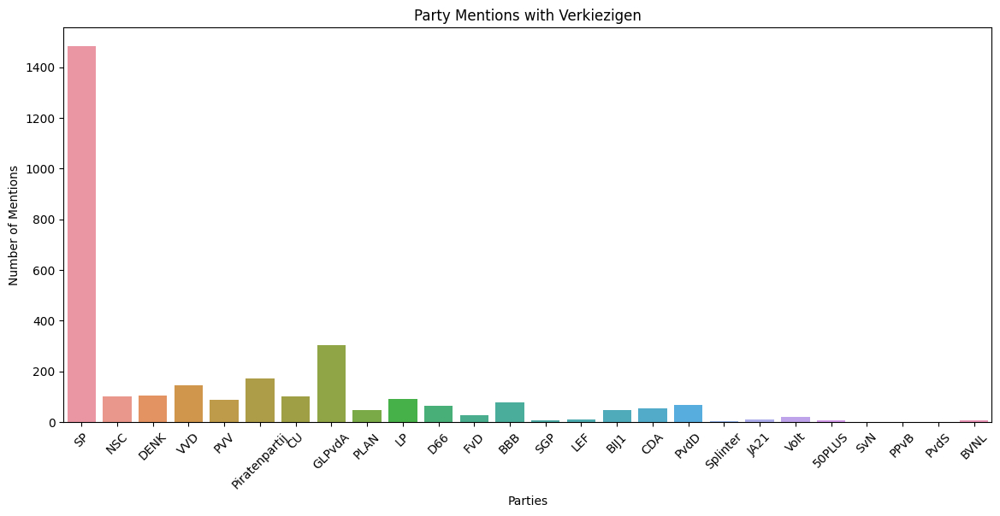

In [11]:
#query_dutch_elections = "dutch elections, verkiezingen, tweedekamer, tweede kamer, kamer, stemmen, stem, stemrecht, #TK2023, #VVD, #D66, #GL, #PvdA, #PVV, #CDA, #SP, #FvD, #PvdD, #CU, #Volt, #JA21, #SGP, #DENK, #50PLUS, #BBB, #BIJ1, #Piratenpartij, #BVNL, #NSC, #Splinter, #LP, #LEF, #SvN, #PLAN, #PvdS, #PPvB"
query_dutch_elections = "dutch elections, verkiezingen, tweedekamer, tweede kamer, kamer, stemmen, stem"
#query_dutch_elections = "dutch elections, #Piratenpartij)"

In [12]:
all_toots_dutch_elections = []
for word in query_dutch_elections.split(', '):
    all_toots_dutch_elections.extend(retrieve_toots(word))
    print(len(all_toots_dutch_elections) and word)


Retrieved 19 toots. Total retrieved: 0
Retrieved 20 toots. Total retrieved: 19
Retrieved 19 toots. Total retrieved: 39
Retrieved 20 toots. Total retrieved: 58
Retrieved 20 toots. Total retrieved: 78
Retrieved 20 toots. Total retrieved: 98
Retrieved 19 toots. Total retrieved: 118
Retrieved 19 toots. Total retrieved: 137
Retrieved 19 toots. Total retrieved: 156
Retrieved 20 toots. Total retrieved: 175
Retrieved 20 toots. Total retrieved: 195
Retrieved 20 toots. Total retrieved: 215
Retrieved 20 toots. Total retrieved: 235
Retrieved 20 toots. Total retrieved: 255
Retrieved 20 toots. Total retrieved: 275
Retrieved 20 toots. Total retrieved: 295
Retrieved 20 toots. Total retrieved: 315
Retrieved 20 toots. Total retrieved: 335
Retrieved 20 toots. Total retrieved: 355
Retrieved 13 toots. Total retrieved: 375
Retrieved 0 toots. Total retrieved: 388
dutch elections
Retrieved 20 toots. Total retrieved: 0
Retrieved 20 toots. Total retrieved: 20
Retrieved 20 toots. Total retrieved: 40
Retrieved 20

In [13]:
print(len(all_toots_dutch_elections))

18230


In [ ]:
## Toots per year for all query results and plots

In [14]:
# Call the function with the all_toots list
toots_per_year_dutch_elections = calculate_toots_per_year(all_toots_dutch_elections)


    Year  Total Toots
0   2023        15078
1   2022         1515
2   2021          250
3   2020          311
4   2018          386
5   2019          378
6   2017           40
7   2016            2
8   2015            2
9   2012            4
10  1998          186
11  2007           77
12  2013            1


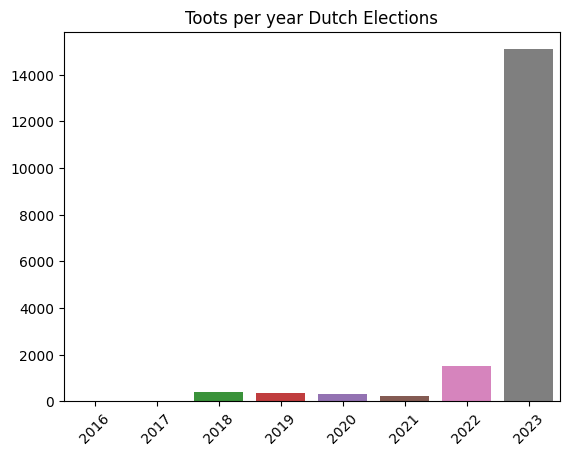

In [17]:
plot_toots_per_year(toots_per_year_dutch_elections, "Dutch Elections")

In [18]:
## Party mentions in the query results

In [19]:
party_mentions_all_toots = count_party_mentions(all_toots_dutch_elections, parties)

In [20]:
print(party_mentions_all_toots)

{'SP': 16061, 'Piratenpartij': 3642, 'GLPvdA': 2778, 'CU': 3123, 'NSC': 559, 'PVV': 420, 'D66': 253, 'Volt': 314, 'PLAN': 2048, 'VVD': 627, 'LP': 972, 'LEF': 316, 'Splinter': 31, 'FvD': 124, '50PLUS': 23, 'DENK': 550, 'BIJ1': 343, 'BBB': 325, 'PvdD': 223, 'CDA': 233, 'SGP': 51, 'JA21': 59, 'SvN': 3, 'PPvB': 2, 'PvdS': 2, 'BVNL': 30}


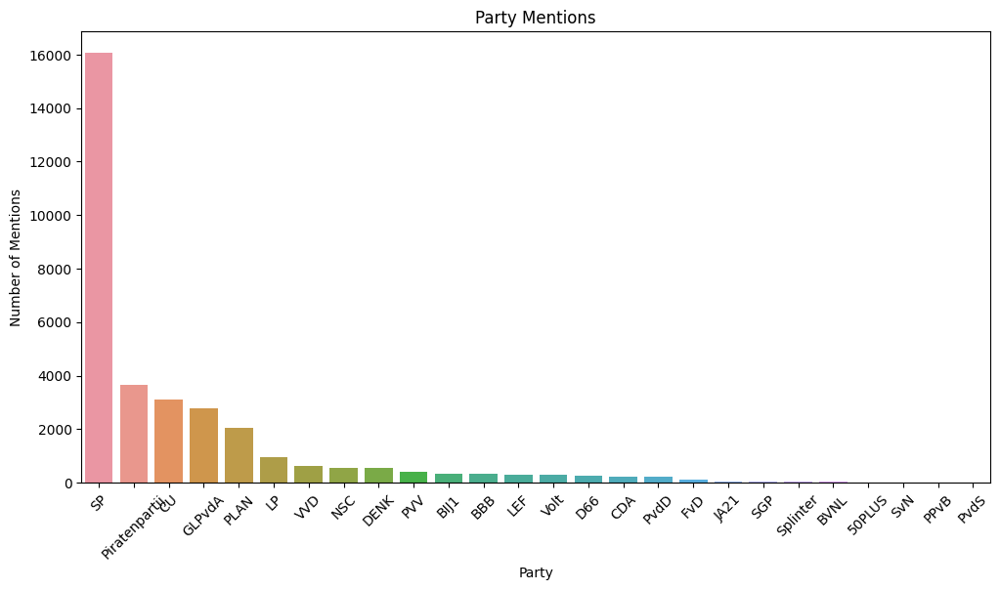

In [26]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert party_mentions dictionary to a dataframe
df = pd.DataFrame.from_dict(party_mentions_all_toots, orient='index', columns=['Mentions'])

# Sort the dataframe by the number of mentions in descending order
df = df.sort_values(by='Mentions', ascending=False)

# Set the figure size
plt.figure(figsize=(12, 6))

# Create a bar plot
sns.barplot(x=df.index, y='Mentions', data=df)

# Add labels and title to the plot
plt.xlabel('Party')
plt.ylabel('Number of Mentions')
plt.title('Party Mentions')

# Rotate the x-labels by 45 degrees
plt.xticks(rotation=45)

# Display the plot
plt.show()


In [27]:
# Write the all_toots list to a file
with open('all_toots_dutch_elections_file.txt', 'w') as f:
    for toot in all_toots_dutch_elections:
        f.write("%s\n" % toot)

In [28]:
#write the all_toots list to a pickle file
import pickle
with open('all_toots_dutch_elections_file.pickle', 'wb') as f:
    pickle.dump(all_toots_dutch_elections, f)



In [29]:
query_words_agenda = "climate, Migration Policy, Migratiebeleid, Economy, Economie, Climate Change, Klimaatverandering, Good Governance, Goed Bestuur, Agriculture, Landbouw, Immigration, Immigratie"

In [30]:
def count_query_mentions(all_toots, parties, query_words):
    party_query_mentions = {}

    for party in parties:
        print(party)
        party_query_mentions[party[0]] = {}

    for toot in all_toots:
        for party in parties:
            print(party)
            for keyword in party:
                if keyword.lower() in toot['content'].lower():
                    for query_word in query_words.split(', '):
                        if query_word.lower() in toot['content'].lower():
                            if query_word in party_query_mentions[party[0]]:
                                party_query_mentions[party[0]][query_word] += 1
                            else:
                                party_query_mentions[party[0]][query_word] = 1

    return party_query_mentions


In [31]:
party_query_mentions = count_query_mentions(all_toots_dutch_elections, parties, query_words_agenda)

['VVD', 'Volkspartij voor Vrijheid en Democratie']
['D66', 'Democraten 66']
['GLPvdA', 'GL', 'PvdA', 'groenlinks', 'GROENLINKS / Partij van de Arbeid', 'GL/PvdA', 'GroenLinks/PvdA']
['PVV', 'Partij voor de Vrijheid']
['CDA', 'Christen-Democratisch Appel']
['SP', 'Socialistische Partij']
['FvD', 'Forum voor Democratie']
['PvdD', 'Partij voor de Dieren']
['CU', 'ChristenUnie']
['Volt']
['JA21']
['SGP', 'Staatkundig Gereformeerde Partij']
['DENK']
['50PLUS']
['BBB', 'Boeren Burger Beweging']
['BIJ1']
['Piratenpartij', 'Piratenpartij – De Groenen', 'De Groenen', 'PP']
['BVNL', 'Belang van Nederland', 'Groep Van Haga']
['NSC', 'Nieuw Sociaal Contract']
['Splinter']
['LP', 'Libertaire Partij']
['LEF', 'Voor de Nieuwe Generatie']
['SvN', 'Samen voor Nederland']
['PLAN', 'Nederland met een PLAN']
['PvdS', 'PartijvdSport']
['PPvB', 'Politieke Partij voor Basisinkomen']
['VVD', 'Volkspartij voor Vrijheid en Democratie']
['D66', 'Democraten 66']
['GLPvdA', 'GL', 'PvdA', 'groenlinks', 'GROENLINKS 

/Users/abhilash/Library/Python/3.7/lib/python/site-packages/seaborn/algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))
/Users/abhilash/Library/Python/3.7/lib/python/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation


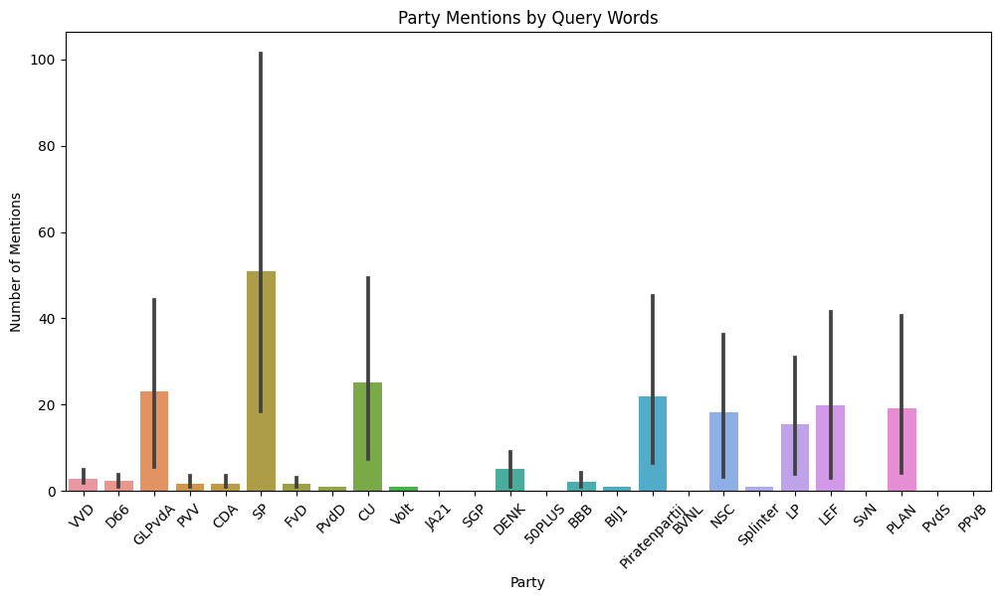

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert party_query_mentions to a dataframe
df = pd.DataFrame.from_dict(party_query_mentions)

# Set the figure size
plt.figure(figsize=(12, 6))

# Create a bar plot
sns.barplot(data=df)

# Add labels and title to the plot
plt.xlabel('Party')
plt.ylabel('Number of Mentions')
plt.title('Party Mentions by Query Words')

# Rotate the x-labels by 45 degrees
plt.xticks(rotation=45)

# Display the plot
plt.show()


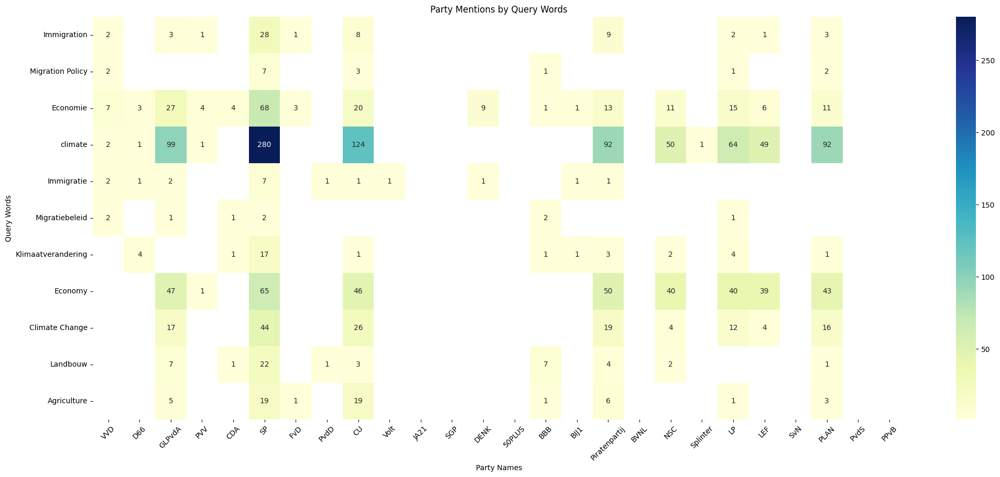

In [35]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert party_query_mentions to a dataframe
df = pd.DataFrame.from_dict(party_query_mentions)

# Set the figure size
plt.figure(figsize=(25, 10))

# Create a heatmap plot
sns.heatmap(df, annot=True, cmap="YlGnBu", fmt=".0f")  # Use fmt=".0f" to display exact numerical values

# Add labels and title to the plot
plt.xlabel('Party Names')
plt.ylabel('Query Words')
plt.title('Party Mentions by Query Words')

# Rotate the x-labels by 45 degrees
plt.xticks(rotation=45)

# Display the plot
plt.show()


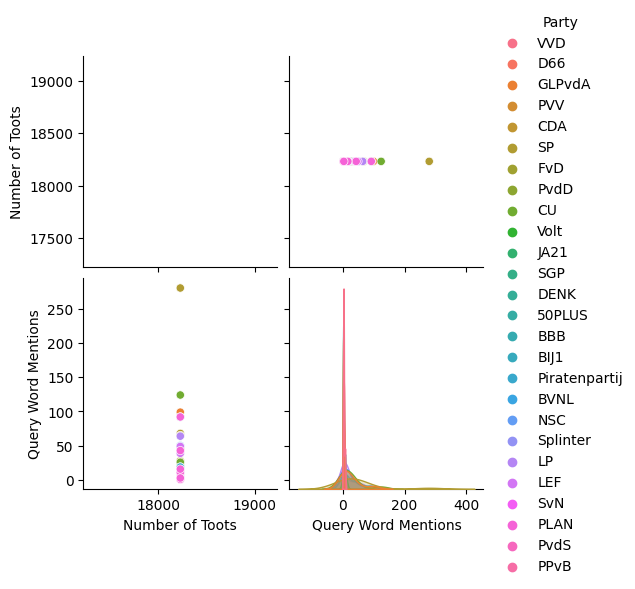

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert party_query_mentions to a dataframe
df = pd.DataFrame.from_dict(party_query_mentions)

# Add a column for the number of toots
df['Number of Toots'] = [len(all_toots_dutch_elections)] * len(df)

# Reshape the dataframe for pairplot
df_pairplot = df.melt(id_vars=['Number of Toots'], var_name='Party', value_name='Query Word Mentions')

# Create a pairplot
sns.pairplot(df_pairplot, hue='Party')

# Display the plot
plt.show()


In [63]:
 official_accounts = {
    "d66": {"bunnik": "D66Bunnik@mastodon.online"},
    "pvdd": {"national": "PartijvoordeDieren@mastodon.nl", "nijmegen": "PvdDNijmegen@mastodon.nl"},
    "piratenpartij":{"national": "Piratenpartij@mastodon.nl", "national": "Piratenpartij@social.globalpirates.net"},
    "bij1": {"national": "BIJ1@social.bij1.org", "utrecht": "UtrechtBIJ1@social.bij1.org"},
    "pvdagl": {"de ronde venen": "PvdAGLDRV@mastodon.nl", "overijssel":"pvdaoverijssel@mastodon.nl"},
    "fvd": {"*national": "fvdemocratie"},
    "volt": {"national": "voltnederland@mastodon.nl"}
}

In [70]:
followers_counts = {}
following_counts = {}

for party, accounts in official_accounts.items():
    followers_counts[party] = {}
    following_counts[party] = {}
    
    for location, account in accounts.items():
        account_info = API.account_search(account)
        if account_info:
            account_id = account_info[0]['id']
            followers = API.account_followers(account_id)
            following = API.account_following(account_id)
            followers_counts[party][location] = len(followers)
            following_counts[party][location] = len(following)

print("Followers counts:")
print(followers_counts)
print("\nFollowing counts:")
print(following_counts)




Followers counts:
{'d66': {'bunnik': 4}, 'pvdd': {'national': 2, 'nijmegen': 40}, 'piratenpartij': {'national': 40}, 'bij1': {'national': 40, 'utrecht': 16}, 'pvdagl': {'de ronde venen': 9, 'overijssel': 11}, 'fvd': {'*national': 27}, 'volt': {'national': 0}}

Following counts:
{'d66': {'bunnik': 6}, 'pvdd': {'national': 1, 'nijmegen': 20}, 'piratenpartij': {'national': 40}, 'bij1': {'national': 3, 'utrecht': 0}, 'pvdagl': {'de ronde venen': 0, 'overijssel': 2}, 'fvd': {'*national': 0}, 'volt': {'national': 0}}


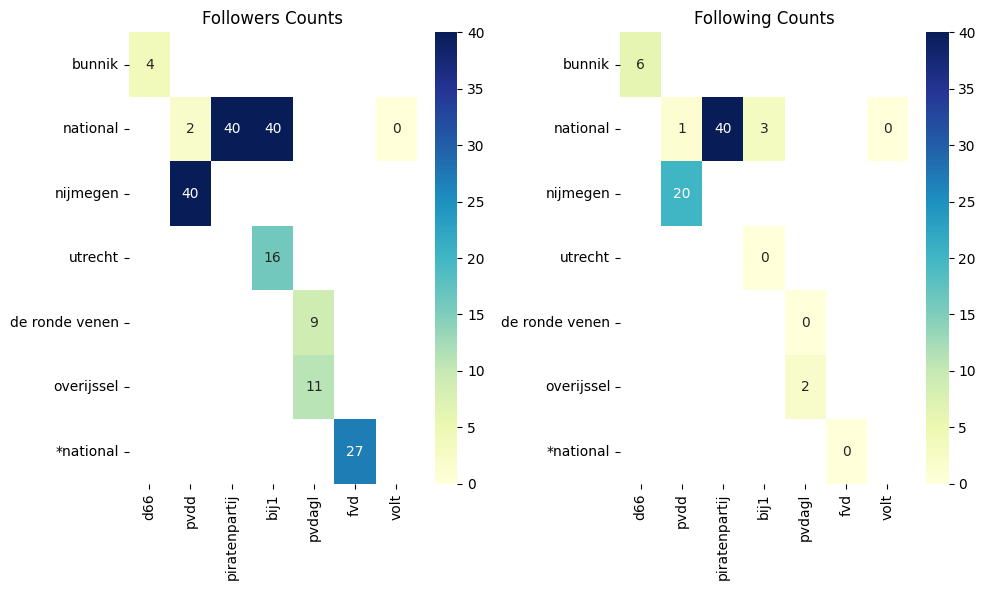

In [78]:
# Convert the followers_counts and following_counts dictionaries to dataframes
followers_df = pd.DataFrame(followers_counts)
following_df = pd.DataFrame(following_counts)

# Set the figure size
plt.figure(figsize=(10, 6))

# Create a heatmap for followers
plt.subplot(1, 2, 1)
sns.heatmap(data=followers_df, annot=True, cmap="YlGnBu", fmt=".0f")
plt.title('Followers Counts')

# Create a heatmap for following
plt.subplot(1, 2, 2)
sns.heatmap(data=following_df, annot=True, cmap="YlGnBu", fmt=".0f")
plt.title('Following Counts')

# Adjust the layout
plt.tight_layout()

# Display the plot
plt.show()
